# DEEP LEARNING -

- Using TensorFloe 2.0 ro classify different Dog Breeds
- We will be using Kaggle dog breed dataset consisting of 10,000+ pictures of 120 breeds
- Multi-class image classification

TensorFlow/Deep Learning workflow:
- Get data ready
- Prepare/pre-processing
- Choose and fit/train the model
- Evalaute the model ( make prediction, comparing with truth labels)
- Improve the model
- Save, share and reload the mdoel


## Getting our libraries today wit tensorFlow

In [36]:
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

# Check for GPU
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.9.2
Hub version: 0.12.0
GPU not available :(


## Getting Data ready
using Google drive, mount drive in the notebook.

In [37]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [38]:
#Unzip the folders
#!unzip "drive/My Drive/Dog Breed/test.zip" -d "drive/MyDrive/Dog Breed/test/"

In [39]:
#Unzip the folders
#!unzip "drive/My Drive/Dog Breed/train.zip" -d "drive/MyDrive/Dog Breed/train/"

## Accesing the data

In [40]:
# Import libraries 

import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt

In [41]:
# Labels of the data

import pandas as pd
labels_csv = pd.read_csv("drive/MyDrive/Dog Breed/labels.csv")
labels_df = pd.DataFrame(labels_csv)

In [42]:
labels_df

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever
...,...,...
10217,ffd25009d635cfd16e793503ac5edef0,borzoi
10218,ffd3f636f7f379c51ba3648a9ff8254f,dandie_dinmont
10219,ffe2ca6c940cddfee68fa3cc6c63213f,airedale
10220,ffe5f6d8e2bff356e9482a80a6e29aac,miniature_pinscher


In [43]:
print(labels_csv.describe(),"\n", labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126 
                                  id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [44]:
breed = labels_csv['breed']

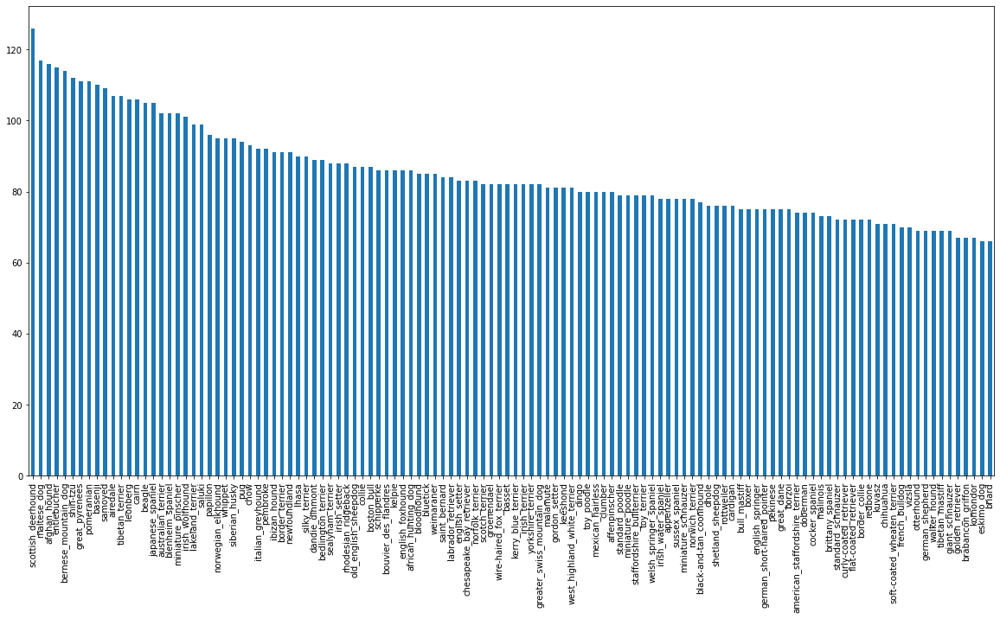

In [45]:
breed.value_counts().plot.bar(figsize=(20,10));

In [46]:
# Mean of the number of dog breeds
breed.value_counts().mean()

85.18333333333334

In [47]:
from IPython.display import display, Image

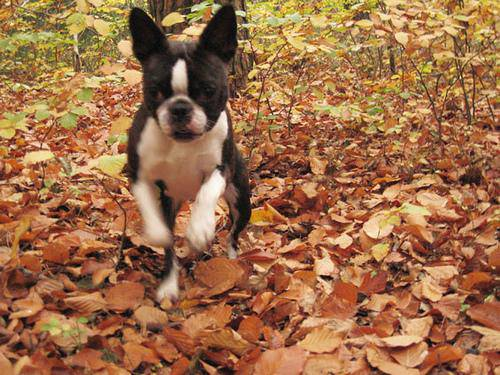

In [48]:
# Displaying an image

Image("drive/My Drive/Dog Breed/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

## Getting images and their labels

We will create
- a list a filepaths to training images
- array of all labels
- array of unique labels

In [49]:
# Create a filepaths for training images
filenames = ["drive/My Drive/Dog Breed/train/"+ fname + ".jpg" for fname in labels_csv["id"]]

In [50]:
filenames[:10]

['drive/My Drive/Dog Breed/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog Breed/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog Breed/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog Breed/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog Breed/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Dog Breed/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Dog Breed/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Dog Breed/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Dog Breed/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Dog Breed/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [51]:
# Check the file names match the actual image filenames

import os
if len(os.listdir("drive/MyDrive/Dog Breed/train")) == len(filenames):
  print("Filenames match the actual amount of files")
else:
  print("Filenames match the actual amount of files")

Filenames match the actual amount of files


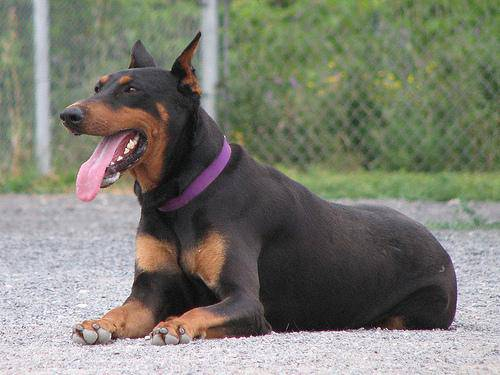

In [52]:
Image(filenames[20])

In [53]:
# Converting labels to np array

labels = labels_csv["breed"].to_numpy()

In [54]:
# See if number of labels matches the number of filenames
if len(labels) == len(filenames):
  print("HOORAY! Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

HOORAY! Number of labels matches number of filenames!


In [55]:
unique_breeds = np.unique(labels)
len(np.unique(labels))  #Unique number of breeds

120

In [56]:
## Turning the labels into boolean array before we put it in ML model

boolean_labels = [label == np.array(unique_breeds) for label in labels]

boolean_labels[:1]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False])]

In [57]:
## Turning the bool values into numericals values

labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [58]:
print(labels[20])
print(np.where(unique_breeds == labels[20])[0][0])
print(boolean_labels[20].argmax())
print(boolean_labels[20].astype(int))

doberman
38
38
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


## Creating a Validation set from Train Set

- Since the kaggle data set doesn't come with validation set, only test set.
- using scikit learn train test split



In [59]:
from sklearn.model_selection import train_test_split

In [60]:
X = filenames
y = boolean_labels

In [61]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [62]:
from ast import Num
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  random_state=42,
                                                  test_size=0.2, )

print(len(X_train), len(y_train), len(X_val), len(y_val))

800 800 200 200


## Pre-processing of Images (turning images in tensors)

We have turned our labels from string to numerical values but our files are still not in suitable type.

> Tensor is a way to turn images into number. a Tensor can be thought of as a combination of NumPy arrays, except with the special ability to be used on a GPU.

To preprocess our images into Tensors we're going to write a function which does a few things:

    i. Takes an image filename as input.
    ii. Uses TensorFlow to read the file and save it to a variable, image.
    iii. Turn our image (a jpeg file) into Tensors.
    iv. Resize the image to be of shape (224, 224).
    v. Return the modified image.

- https://www.tensorflow.org/tutorials/load_data/images




In [63]:
# Conerting images as Numpy array

from matplotlib.pyplot import imread

image = imread(filenames[38])
image.shape

(500, 375, 3)

 Shape of image (Height, Weight, No. of color channels) is (500,375,3)

In [64]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 375, 3), dtype=uint8, numpy=
array([[[120, 168,  82],
        [ 97, 146,  55],
        [ 78, 128,  33],
        ...,
        [ 91, 120,  40],
        [105, 131,  57],
        [120, 143,  71]],

       [[111, 160,  71],
        [ 98, 147,  56],
        [ 78, 128,  33],
        ...,
        [108, 147,  64],
        [115, 152,  74],
        [116, 150,  76]]], dtype=uint8)>

In [65]:
from tensorflow.python.types.core import Tensor
img_size = 224

def process_image(image_path):
  """
  Turn images into Tensor
  """

  image = tf.io.read_file(image_path) # read image file

  image = tf.image.decode_jpeg(image, channels=3) #turn image into tensor with 3 color channels

  image = tf.image.convert_image_dtype(image, tf.float32) #converting color channels from 0-225 to 0-1

  image = tf.image.resize(image, size=[img_size, img_size])

  return image


## Creating Data Batches

- We have created a funtion to convert out images to tensor
- We will convert our  images into batches; TensorFlow [`BatchDataset`](https://www.tensorflow.org/guide/data#batching_dataset_elements))

- A batch (also called mini-batch) is a small portion of your data, say 32 (32 is generally the default batch size) images and their labels. In deep learning, instead of finding patterns in an entire dataset at the same time, you often find them one batch at a time.

Let's say you're dealing with 10,000+ images (which we are). Together, these files may take up more memory than your GPU has. Trying to compute on them all would result in an error.

Instead, it's more efficient to create smaller batches of your data and compute on one batch at a time.

In [66]:
def get_image_label(image_path, label):

  """ 
  take image and label to return (image, label) tuple
  """

  image = process_image(image_path)

  return(image, label)

In [67]:
BATCH_SIZE = 32  # 32 is a suitable default size

# Function to create batches

def create_data_batch(x,y=None, batch_size = BATCH_SIZE, valid_data=False, test_data=False):

  """
  Where x is image and y is label
  """

  # since test data do not have labels yet

  if test_data:
    print("Creating test data batches....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only x or filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  elif valid_data:
    print("Creating Validation data batches.....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                               tf.constant(y))) #both filepaths and labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch  

  else:
    print("Creating training data batches.....")

    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),tf.constant(y)))
    
    data = data.shuffle(buffer_size=len(x))  # Shuffling the images and labels before mapping is faster
    data = data.map(get_image_label)
    data_batch = data.batch(BATCH_SIZE)

  return data_batch

In [68]:
train_data = create_data_batch(X_train, y_train)
val_data = create_data_batch(X_val, y_val, valid_data=True)

Creating training data batches.....
Creating Validation data batches.....


## Visualizing the data batches

In [69]:
def show_images(images, labels):
  #n = int(input("how many images do you want to see? nxn = "))

  plt.figure(figsize=(10,10))

  for i in range(25):
    ax=plt.subplot(5,5,i+1)
    plt.imshow(images[i])
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis("off")

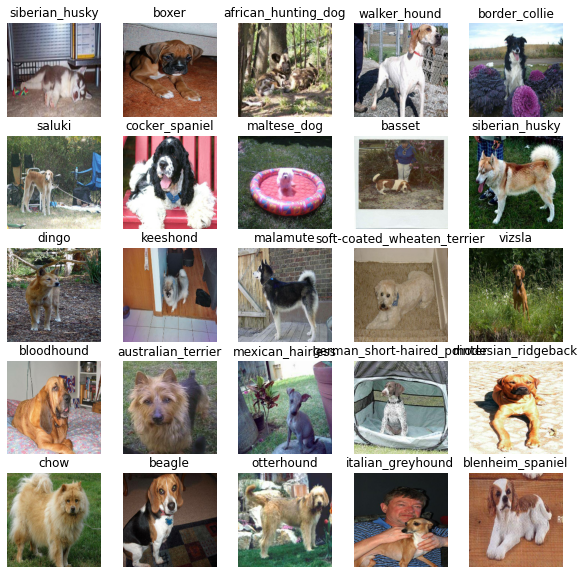

In [70]:
# Display Train images

train_images, train_labels = next(train_data.as_numpy_iterator())
show_images(train_images,train_labels)

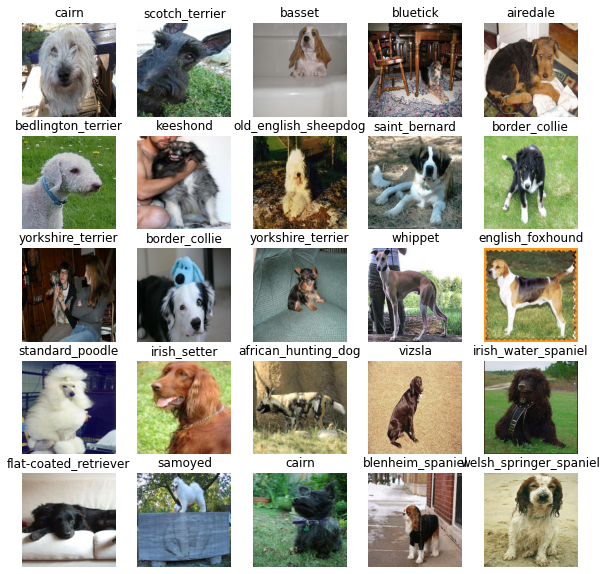

In [71]:
# Display Validation images

val_images, val_labels = next(val_data.as_numpy_iterator())
show_images(val_images,val_labels)

## Creating and Training a model

- We will use existing model from TensorFlow. (Transfer Learning)
- Because, training and learning a model from scratch would be time intensive

### BUilding a model

Define
- Input shape
- output shape
- URL of the model we use


In [72]:
# Input shape
INPUT_SHAPE = [None, img_size, img_size,3]

# Output shape
OUTPUT_SHAPE = len(unique_breeds) # no. of unique labels
            
# Model URL
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

#### Let's create a function which:

    - Takes the input shape, output shape and the model we've chosen's URL as parameters.
    - Defines the layers in a Keras model in a sequential fashion (do this first, then this, then that).
    - Compiles the model (says how it should be evaluated and improved).
    - Builds the model (tells it what kind of input shape it'll be getting).
    - Returns the model.


In [73]:
from tensorflow._api.v2.config import optimizer
def create_model(input_shape=INPUT_SHAPE, 
                 output_shape = OUTPUT_SHAPE,
                 model_url=MODEL_URL):
  
  print("Building Model using:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([hub.KerasLayer(MODEL_URL),  #Layer 1 (input layer)
                               tf.keras.layers.Dense(units=OUTPUT_SHAPE, 
                                                     activation="softmax") #Layer 2 output layer
                               ])
  
  # Compile the model
  model.compile(loss = tf.keras.losses.CategoricalCrossentropy(), # reduce the loss ( wrong guess )
                optimizer=tf.keras.optimizers.Adam(), # how model tries to improve its guesses
                metrics=["accuracy"])  # increase the metrics
  
  # Build the model
  model.build(INPUT_SHAPE)

  return model


In [74]:
# Create the model and check its details

model = create_model()
model.summary()

Building Model using: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


### Creating Callbacks

Callbacks are helper functions a model can use during training to do things such as save a models progress, check a models progress or stop training early if a model stops improving.
- **TensorBoard and Early Stop Callbacks**

- To set up a TensorBoard callback and view TensorBoard in a notebook, we need to do three things:

    1. Load the TensorBoard notebook extension.
    2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's fit() function.
    3. Visualize the our models training logs using the %tensorboard magic function (we'll do this later on).


In [75]:
# Load the TensorBoard notebook extensions
%load_ext tensorboard

In [76]:
import datetime

# Create function to build TB callback

def create_tensorboard_cb():

   # log dictionary for storing the tb logs
   logdir = os.path.join("drive/MyDrive/Dog Breed/logs",
                         datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
   
   return tf.keras.callbacks.TensorBoard(logdir)

#### Early stopping callbacks
- helps overfitting


In [77]:
# Early stopping callbacks
early_stop = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                              patience=3) # stops after 3 rounds of no improvements
                                              

# Training the model

- we will train the model on 1000 images.
- Define no. of epochs: no. of passes of the data our model would like to look at.

In [78]:
# Check again if GPU is available (otherwise computing will take a looooonnnnggggg time)
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU not available :(


In [79]:
# How many rounds should we get the model to look through the data?
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

Let's create a simple function which trains a model. The function will:

  - Create a model using create_model().
  - Setup a TensorBoard callback using create_tensorboard_callback() (we do this here so it creates a log directory of the current date and time).
  - Call the fit() function on our model passing it the training data, validatation data, number of epochs to train for and the callbacks we'd like to use.
  - Return the fitted model.



In [80]:
# Build a function to train and return a trained model

def train_model():

  """
  Train a given model and return the trained version
  """

  # create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_cb()

  # Fit the model to data passing 

  model.fit(x=train_data,
            epochs = NUM_EPOCHS,
            validation_data=val_data,
            validation_freq = 1,
            callbacks=[tensorboard, early_stop])
  
  return model

In [81]:
# Fit the model

model = train_model()

Building Model using: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 310s 12s/step - loss: 4.5518 - accuracy: 0.1075 - val_loss: 3.3429 - val_accuracy: 0.3050
Epoch 2/100
25/25 [==============================] - 56s 2s/step - loss: 1.6358 - accuracy: 0.7025 - val_loss: 2.1546 - val_accuracy: 0.5050
Epoch 3/100
25/25 [==============================] - 48s 2s/step - loss: 0.5768 - accuracy: 0.9362 - val_loss: 1.6779 - val_accuracy: 0.5600
Epoch 4/100
25/25 [==============================] - 42s 2s/step - loss: 0.2586 - accuracy: 0.9812 - val_loss: 1.5238 - val_accuracy: 0.6050
Epoch 5/100
25/25 [==============================] - 40s 2s/step - loss: 0.1487 - accuracy: 0.9975 - val_loss: 1.4439 - val_accuracy: 0.6200
Epoch 6/100
25/25 [==============================] - 42s 2s/step - loss: 0.1031 - accuracy: 0.9987 - val_loss: 1.4032 - val_accuracy: 0.6100
Epoch 7/100
25/25 [==============================] - 42s 2

### Checking the TensorBoard Logs
- checking the performance visually.

In [86]:
%tensorboard --logdir drive/My\ Drive/Dog\ Breed/logs

<IPython.core.display.Javascript object>

## Making evaluations and Predictions usingt the trained model

In [87]:
# Making predictions
predictions = model.predict(val_data, verbose=1)
predictions

7/7 [==============================] - 8s 1s/step


array([[2.67718267e-03, 4.14289243e-05, 1.29654817e-03, ...,
        5.07375167e-04, 2.25294352e-05, 2.82229506e-03],
       [1.41289097e-03, 2.89554795e-04, 2.11592531e-03, ...,
        1.14085698e-04, 1.02948141e-03, 2.48126908e-05],
       [4.78383163e-06, 7.78210233e-06, 2.14496067e-05, ...,
        1.15230714e-05, 2.43945506e-05, 3.39048675e-05],
       ...,
       [7.00162400e-06, 1.29553891e-05, 6.99727461e-05, ...,
        2.90842468e-06, 2.66941315e-05, 3.27828384e-05],
       [3.20962863e-03, 6.04727429e-05, 1.99584989e-04, ...,
        2.30520513e-04, 9.75270632e-06, 2.64379121e-02],
       [1.05128594e-04, 9.31317991e-05, 3.06867249e-03, ...,
        9.10208840e-03, 8.04493437e-04, 1.77765003e-04]], dtype=float32)

In [88]:
predictions.shape

(200, 120)

In [91]:
# First Prediction

print(predictions[0])
print(f"Max Value (probability of prediction): {np.max(predictions[0])}")
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label


[2.67718267e-03 4.14289243e-05 1.29654817e-03 9.09366063e-05
 1.83132026e-04 1.16707306e-05 1.51238535e-02 6.71192771e-04
 3.24149551e-05 4.61290416e-04 1.19440025e-04 4.32374800e-05
 5.16873552e-04 4.72566790e-05 7.98461027e-04 1.33157257e-04
 5.63024587e-05 1.64971128e-01 1.68682018e-05 5.43871247e-05
 1.36720162e-04 6.75104893e-05 1.13443939e-05 1.52931060e-03
 2.47005755e-05 3.19125160e-04 1.52772024e-01 4.12006375e-05
 7.95481610e-04 3.84849773e-05 2.63329730e-05 1.08921132e-03
 1.10288813e-04 8.43709677e-06 3.80259280e-06 2.81314384e-02
 1.44759624e-05 5.21525653e-05 1.12655180e-05 2.75275888e-05
 7.42097211e-04 3.38862264e-05 2.17014604e-04 1.35477065e-04
 1.74270554e-05 1.33448688e-04 1.33721651e-05 1.13887458e-04
 1.60736308e-04 1.05027961e-04 3.16310761e-04 2.53521557e-05
 1.85956320e-04 1.58570707e-04 6.08452574e-05 1.97347144e-05
 1.88788545e-04 1.46386831e-03 6.65223997e-05 6.01415858e-02
 8.19180277e-05 2.03529507e-05 9.61858896e-04 9.12983069e-06
 5.12793486e-04 2.494487

In [92]:
# Turning the probabilities into respective label

def get_pred_label(prediction_probabilities):
  
  return unique_breeds[np.argmax(prediction_probabilities)]

In [93]:
pred_label = get_pred_label(predictions[0])
pred_label

'silky_terrier'

#### Create unbatch to batch dataset

In [95]:
def unbatchify(data):

  images = []
  labels = []

  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])

  return images, labels

In [96]:
# Unbatch th evalidation data

val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [107]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  
  # Get the pred label
  pred_label = get_pred_label(pred_prob)
  
  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

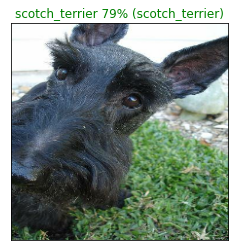

In [108]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)


Let's build a function to demonstrate. The function will:
* Take an input of a prediction probabilities array, a ground truth labels array and an integer.
* Find the predicted label using `get_pred_label()`.
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels
* Plot the top 10 prediction probability values and labels, coloring the true label green.

In [109]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

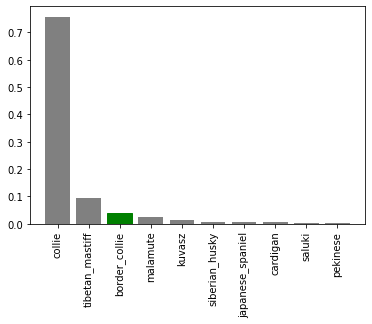

In [110]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

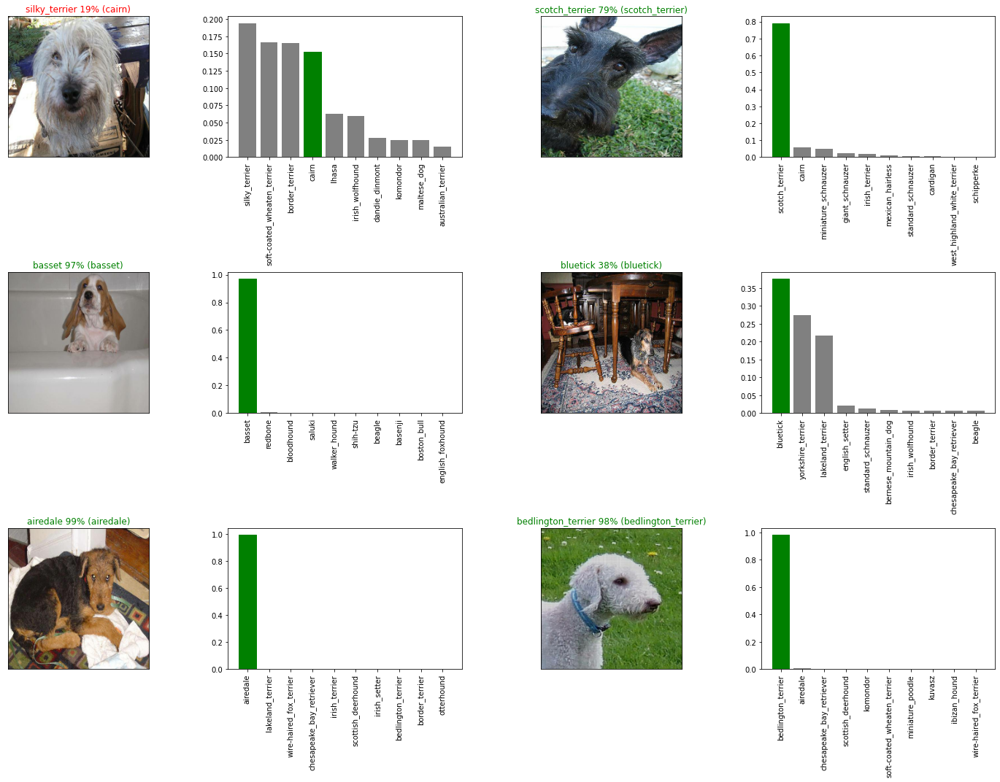

In [111]:
# Visualize the predictions, their probability and the labels

i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and relaoding the model
- to enable sharing for later use.


In [112]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/My Drive/Dog Breed/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [114]:
from tensorflow_hub.keras_layer import KerasLayer
# Loading the model using a function

def load_model(model_path):
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model
  
  

In [115]:
# Saving model trained on 1000 images
save_model(model, suffix="1000-images-Adam")

Saving model to: drive/My Drive/Dog Breed/models/20230113-02151673576145-1000-images-Adam.h5...


'drive/My Drive/Dog Breed/models/20230113-02151673576145-1000-images-Adam.h5'

In [117]:
# Load our model trained on 1000 images
model_1000_images = load_model('drive/My Drive/Dog Breed/models/20230113-02151673576145-1000-images-Adam.h5')

Loading saved model from: drive/My Drive/Dog Breed/models/20230113-02151673576145-1000-images-Adam.h5


##### Compare the two models (the one originally created and saved/loaded model)


In [118]:
# Evaluate the original model
model.evaluate(val_data)

7/7 [==============================] - 11s 1s/step - loss: 1.2510 - accuracy: 0.6600


[1.2509539127349854, 0.6600000262260437]

In [119]:
#Evaluate the saved/loaded data
model_1000_images.evaluate(val_data)

7/7 [==============================] - 12s 1s/step - loss: 1.2510 - accuracy: 0.6600


[1.2509539127349854, 0.6600000262260437]

# Training the Model on FULL DATASET
- Since the model works on subset of the data, we can train the model on full data

In [121]:
len(X), len(y)

(10222, 10222)

In [122]:
full_data = create_data_batch(X,y)

Creating training data batches.....


In [123]:
full_model = create_model()

Building Model using: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [124]:
# Creating Callbacks

# TensorBoard Callback

full_model_tensorboard = create_tensorboard_cb()

#Early Stopping Callback

full_model_earlystop = tf.keras.callbacks.EarlyStopping(monitor="accuracy", patience=3)

In [125]:
%tensorboard --logdir drive/My\ Drive/Dog\ Breed/logs

Reusing TensorBoard on port 6006 (pid 14550), started 0:47:13 ago. (Use '!kill 14550' to kill it.)

<IPython.core.display.Javascript object>

# Fit the full model to full training data

In [126]:
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard,
                          full_model_earlystop])

Epoch 1/100
320/320 [==============================] - 457s 1s/step - loss: 1.3438 - accuracy: 0.6691
Epoch 2/100
320/320 [==============================] - 495s 2s/step - loss: 0.3919 - accuracy: 0.8858
Epoch 3/100
320/320 [==============================] - 520s 2s/step - loss: 0.2338 - accuracy: 0.9371
Epoch 4/100
320/320 [==============================] - 450s 1s/step - loss: 0.1518 - accuracy: 0.9635
Epoch 5/100
320/320 [==============================] - 417s 1s/step - loss: 0.1038 - accuracy: 0.9788
Epoch 6/100
320/320 [==============================] - 416s 1s/step - loss: 0.0765 - accuracy: 0.9865
Epoch 7/100
320/320 [==============================] - 409s 1s/step - loss: 0.0600 - accuracy: 0.9914
Epoch 8/100
320/320 [==============================] - 422s 1s/step - loss: 0.0457 - accuracy: 0.9944
Epoch 9/100
320/320 [==============================] - 418s 1s/step - loss: 0.0371 - accuracy: 0.9962
Epoch 10/100
320/320 [==============================] - 416s 1s/step - loss: 0.030

### Saving and reloading the full model

In [127]:
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/My Drive/Dog Breed/models/20230113-04481673585326-all-images-Adam.h5...


'drive/My Drive/Dog Breed/models/20230113-04481673585326-all-images-Adam.h5'

In [128]:
loaded_full_model = load_model('drive/My Drive/Dog Breed/models/20230113-04481673585326-all-images-Adam.h5')

Loading saved model from: drive/My Drive/Dog Breed/models/20230113-04481673585326-all-images-Adam.h5


## Making Predictions on Test Datasets

To make predictions on the test data, we'll:

- Get the test image filenames.
- Convert the filenames into test data batches using create_data_batches() and setting the test_data parameter to True (since there are no labels with the test images).
- Make a predictions array by passing the test data batches to the predict() function.


In [129]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "drive/My Drive/Dog Breed/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['drive/My Drive/Dog Breed/test/e7b4b0e7d7d76f8dbd64920f34443b25.jpg',
 'drive/My Drive/Dog Breed/test/e6c9d8058cbc9b1665aecac1ae179288.jpg',
 'drive/My Drive/Dog Breed/test/e76a7a1d23d687b5015b07df762c0c10.jpg',
 'drive/My Drive/Dog Breed/test/e783e22d4f370b6cc0b1f44b4d6584a8.jpg',
 'drive/My Drive/Dog Breed/test/e7129bc2dbbba99bedc87c7787cbdf1f.jpg',
 'drive/My Drive/Dog Breed/test/e751e319cfdc9912ae2e5da2a9b053e0.jpg',
 'drive/My Drive/Dog Breed/test/e7feb64da6aae1ef8e62453f6660d0c5.jpg',
 'drive/My Drive/Dog Breed/test/e6da14858db7781843db6af91551f627.jpg',
 'drive/My Drive/Dog Breed/test/e7ed96b272013c6de9505a753816ce75.jpg',
 'drive/My Drive/Dog Breed/test/e71d9f32ea6eb1c2d944e8f4e811c209.jpg']

In [130]:
len(test_filenames)

10357

In [131]:
# Creating test batches
test_data = create_data_batch(test_filenames, test_data=True)

Creating test data batches....


In [132]:
# Making Predictions on test data batches using loaded full model
test_predictions = loaded_full_model.predict(test_data, verbose=1)

324/324 [==============================] - 651s 2s/step


In [133]:
test_predictions[:10]

array([[1.8679349e-09, 1.5701286e-10, 3.3613006e-08, ..., 2.1185726e-07,
        1.6263532e-05, 3.5611734e-08],
       [9.6386288e-10, 2.2414461e-09, 2.9443756e-09, ..., 1.3589498e-05,
        1.2187861e-08, 2.6838070e-12],
       [9.7743409e-15, 1.8226318e-14, 1.2211376e-09, ..., 1.8815804e-09,
        4.2001916e-10, 2.6552417e-12],
       ...,
       [1.0504397e-05, 1.1447590e-05, 3.3438606e-05, ..., 3.1100273e-05,
        7.0380213e-10, 7.6671989e-07],
       [3.9643378e-08, 6.1322654e-09, 2.6789665e-10, ..., 1.3808589e-10,
        1.1311218e-07, 1.1026973e-03],
       [6.7063510e-10, 1.7456932e-04, 8.9094774e-06, ..., 1.2472145e-06,
        8.5862790e-04, 9.7652525e-04]], dtype=float32)

# Making Predictions on Custom Images

using the model we creaeted we will test it on custom images.

To do so, we'll:

    Get the filepaths of our own images.
    Turn the filepaths into data batches using create_data_batches(). And since our custom images won't have labels, we set the test_data parameter to True.
    Pass the custom image data batch to our model's predict() method.
    Convert the prediction output probabilities to prediction labels.
    Compare the predicted labels to the custom images.

Note: To make predictions on custom images, I've uploaded pictures of my own to a directory located at drive/My Drive/Data/dogs/ (as seen in the cell below). In order to make predictions on your own images, you will have to do something similar.

In [164]:
# Get custom image filepaths
custom_path = "drive/My Drive/dogs/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [166]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batch(custom_image_paths, test_data=True)

Creating test data batches....


In [167]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

1/1 [==============================] - 0s 178ms/step


In [168]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['french_bulldog', 'siberian_husky', 'chihuahua']

In [169]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

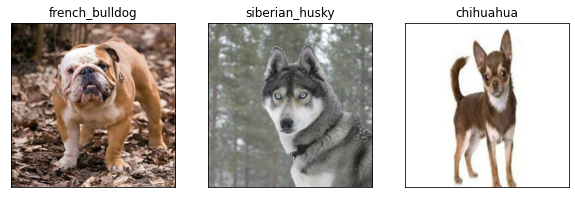

In [170]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)